In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install -q tfimm
!pip3 install -q timm==0.6.13
!pip3 install tensorflow-addons
!pip3 install numba

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [1]:
import sys, os, glob, pathlib, shap, warnings, tfimm, shutil, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from tensorflow_addons.optimizers import AdamW

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_ViT, display_gradcam
from distillation_ViT import DeiT, ViTDistilled
from distillation import Distiller
from student_vit import StudentViT
from occlusion_maps import OcclusionMaps
from rise import RISE



TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.10.0 and strictly below 2.13.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/a

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<h1>Load Dataset</h1>

In [ ]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v4.zip'

In [ ]:
for url in glob.glob('/content/dataset_CD_UC/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  imsave('/content/dataset_CD_UC/ulcerative-colitis/'+url.split('/')[4], img)

In [ ]:
os.mkdir('/content/frames/frames_train')
os.mkdir('/content/frames/frames_test')

os.mkdir('/content/frames/frames_train/crohn-disease')
os.mkdir('/content/frames/frames_train/ulcerative-colitis')

os.mkdir('/content/frames/frames_test/crohn-disease')
os.mkdir('/content/frames/frames_test/ulcerative-colitis')

In [ ]:
for url in glob.glob('/content/frames-crop/*.jpg'):
  img = imread(url)
  imsave('/content/frames/frames_test/ulcerative-colitis/'+url.split('/')[3], img)

list_files = [name for name in glob.glob('/content/frames/ulcerative-colitis/*.jpg')]
for a in list_files:
  shutil.move(a, '/content/frames/frames_train/ulcerative-colitis/')

In [ ]:
os.rmdir(pathlib.Path('/content/frames/ulcerative-colitis'))
!rm -r '/content/dataset_CD_UC/ulcerative-colitis-crop/'
!rm -r '/content/frames-crop/'

In [2]:
data_dir = pathlib.Path('/content/dataset_CD_UC')
data_dir_frames_train = pathlib.Path('/content/frames/frames_train')
data_dir_frames_test = pathlib.Path('/content/frames/frames_test')

# Input size initial
batch_size = 32
IMG_SIZE = (224, 224)

# Distillation
BASE_LR = 1e-5
WEIGHT_DECAY = 0.0001
lr_scaled = (BASE_LR / 512) * batch_size

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2205 files belonging to 2 classes.
Using 662 files for training.
Found 2205 files belonging to 2 classes.
Using 661 files for validation.
['crohn-disease', 'ulcerative-colitis']


In [3]:
frames_train = image_dataset_from_directory(data_dir_frames_train,image_size=IMG_SIZE,batch_size=batch_size)
frames_test = image_dataset_from_directory(data_dir_frames_test,image_size=IMG_SIZE,batch_size=batch_size)

train_ds = train_ds.concatenate(frames_train)
test_ds = test_ds.concatenate(frames_test)

Found 34 files belonging to 2 classes.
Found 30 files belonging to 2 classes.


Found 2205 files belonging to 2 classes.


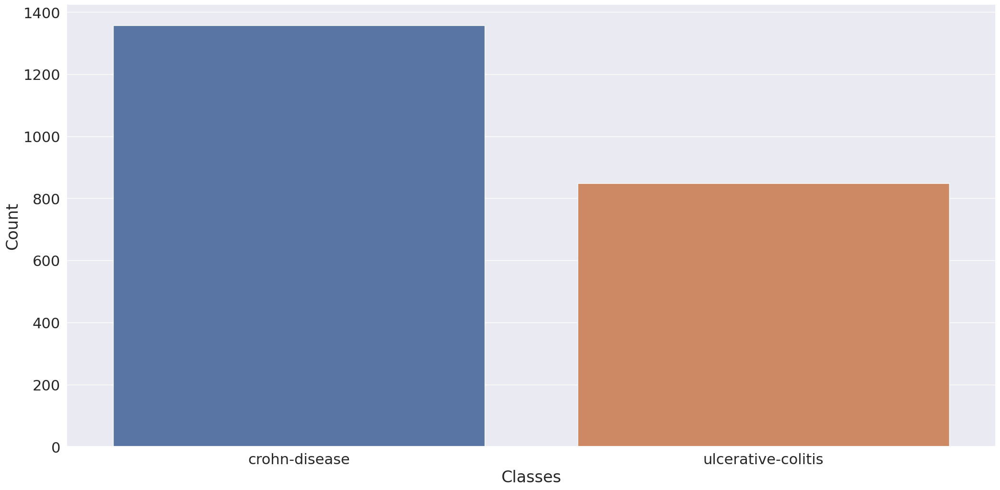

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

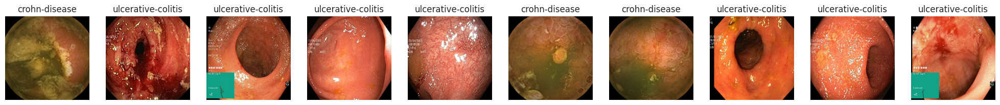

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [4]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [5]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [6]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [7]:
inputs = Input(shape=IMG_SIZE+(3,))
outputs = ViTDistilled().call(inputs)
student_model_1 = Model(inputs, outputs)

student_model_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.compat.v1.shape (TFOpLambda  (4,)                0           ['input_1[0][0]']                
 )                                                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  ()                  0           ['tf.compat.v1.shape[0][0]']     
 ingOpLambda)                                                                                 

In [8]:
inputs = Input(shape=IMG_SIZE+(3,))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
outputs = StudentViT(16).call(x)
student_model_2 = Model(inputs, outputs)

student_model_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['sequential[0][0]']             
                                                                                                  
 patches (Patches)              (None, None, 768)    0           ['rescaling[0][0]']        

<h1>Images to Interpretability</h1>

In [ ]:
for url in glob.glob('/content/test/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  imsave('/content/test/ulcerative-colitis/'+url.split('/')[4], img)

In [ ]:
!rm -r '/content/test/ulcerative-colitis-crop/'

In [9]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability = np.concatenate(images_exp)
labels_interpretability = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


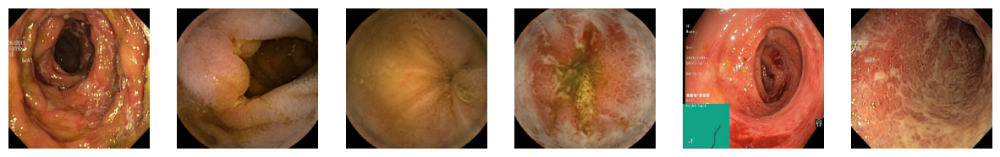

In [10]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [11]:
print('*** Ground truth ***\n')
for val in labels_interpretability:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis


# ViT_B/32

In [ ]:
vit_model = tfimm.create_model("vit_base_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_preprocessing = tfimm.create_preprocessing("vit_base_patch32_224_in21k")

inputs = Input(shape=(224, 224,3))
x = data_augmentation(inputs)
x = vit_model_preprocessing(x)
x = vit_model.call(x)
outputs = layers.Dense(len(class_names))(x)
model_vit_b32 = Model(inputs, outputs)

In [ ]:
model_vit_b32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_vit_b32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 30s 625ms/step - loss: 0.1909 - accuracy: 0.9167 - val_loss: 0.0112 - val_accuracy: 0.9979
Epoch 2/200
23/23 [==============================] - 12s 496ms/step - loss: 0.0030 - accuracy: 1.0000 - val_loss: 0.0037 - val_accuracy: 1.0000
Epoch 3/200
23/23 [==============================] - 12s 483ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 4/200
23/23 [==============================] - 12s 464ms/step - loss: 9.4503e-04 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 12s 497ms/step - loss: 5.2928e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 12s 487ms/step - loss: 6.1211e-04 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 13s 531ms/step - loss: 4.5031e-04 - accuracy: 1.0000 - val_loss: 9.3956

<Axes: >

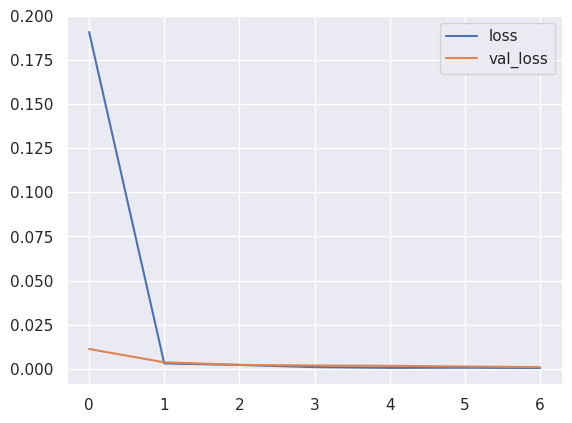

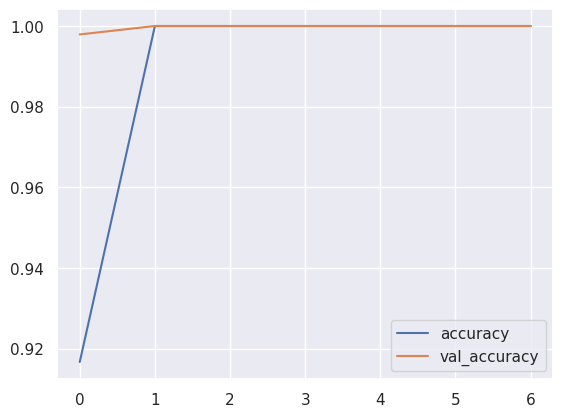

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history['val_loss'].mean()))

Accuracy for Train: 0.9881
Loss for Train: 0.0284
Accuracy for Test: 0.9997
Loss for Test: 0.0033


In [ ]:
start = time.time()
predict_labels_ = model_vit_b32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_vit_b32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 1.0000
Loss: 0.0013
Inference Time: 3.16s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


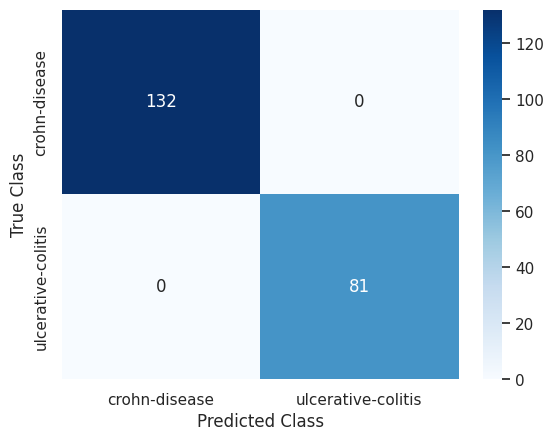

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h2>Knowledge Distillation</h2>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_b32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, batch_size=batch_size, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 16s 234ms/step - accuracy: 0.5805 - student_loss: 1.3708 - distillation_loss: 12.9105 - val_accuracy: 0.8096 - val_student_loss: 0.4483
Epoch 2/100
23/23 [==============================] - 6s 232ms/step - accuracy: 0.6322 - student_loss: 1.1766 - distillation_loss: 12.3180 - val_accuracy: 0.6904 - val_student_loss: 0.4099
Epoch 3/100
23/23 [==============================] - 6s 235ms/step - accuracy: 0.6422 - student_loss: 1.2206 - distillation_loss: 12.3724 - val_accuracy: 0.5962 - val_student_loss: 0.0717
Epoch 4/100
23/23 [==============================] - 5s 208ms/step - accuracy: 0.6034 - student_loss: 1.3475 - distillation_loss: 11.2284 - val_accuracy: 0.8808 - val_student_loss: 0.6061
Epoch 5/100
23/23 [==============================] - 7s 247ms/step - accuracy: 0.7443 - student_loss: 0.6281 - distillation_loss: 8.5413 - val_accuracy: 0.8849 - val_student_loss: 0.0715
Epoch 6/100
23/23 [==============================] - 5s 212m

<Axes: >

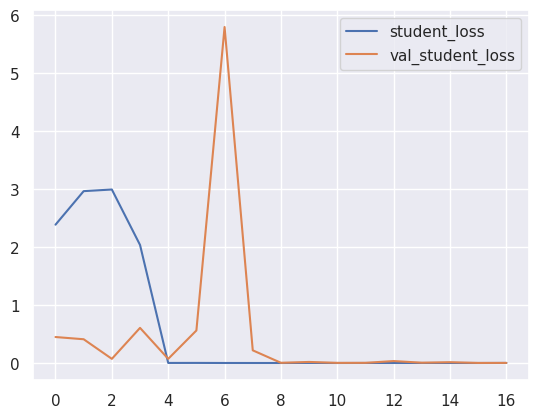

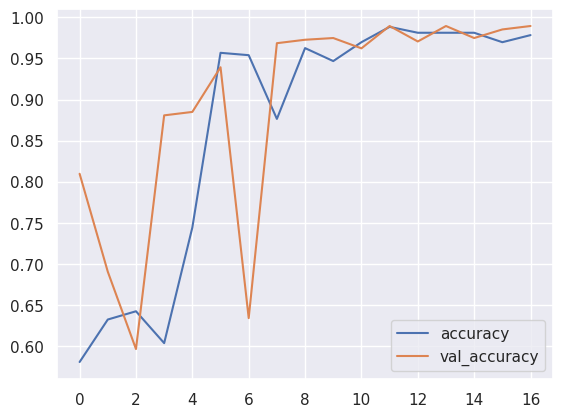

In [ ]:
distiller_history_2 = pd.DataFrame(distillation_history.history)
distiller_history_2.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history_2['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history_2['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history_2['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history_2['val_student_loss'].mean()))

Accuracy for Train: 0.8676
Loss for Train: 0.6111
Accuracy for Test: 0.8949
Loss for Test: 0.4863


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 1.0000
Loss: 0.0030
Inference Time: 1.52s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


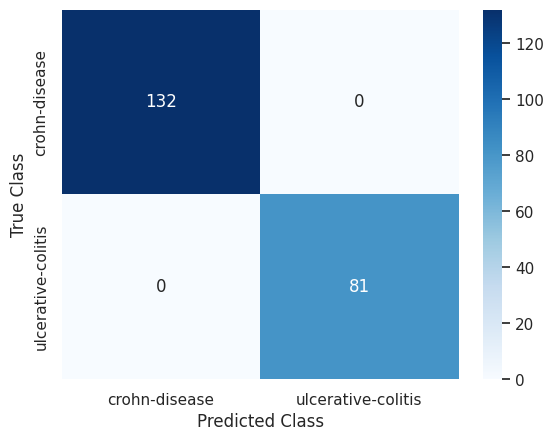

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 30s 440ms/step - accuracy: 0.5216 - student_loss: 0.8695 - distillation_loss: 0.8916 - val_accuracy: 0.5732 - val_student_loss: 0.7099 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 19s 399ms/step - accuracy: 0.5165 - student_loss: 0.8185 - distillation_loss: 0.8246 - val_accuracy: 0.5921 - val_student_loss: 0.6564 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 18s 394ms/step - accuracy: 0.6070 - student_loss: 0.7628 - distillation_loss: 0.7373 - val_accuracy: 0.5732 - val_student_loss: 0.6404 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 19s 406ms/step - accuracy: 0.6329 - student_loss: 0.7159 - distillation_loss: 0.6991 - val_accuracy: 0.5921 - val_student_loss: 0.6064 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 19s 408ms/step - accuracy: 0.6667 - student_loss: 0

<Axes: >

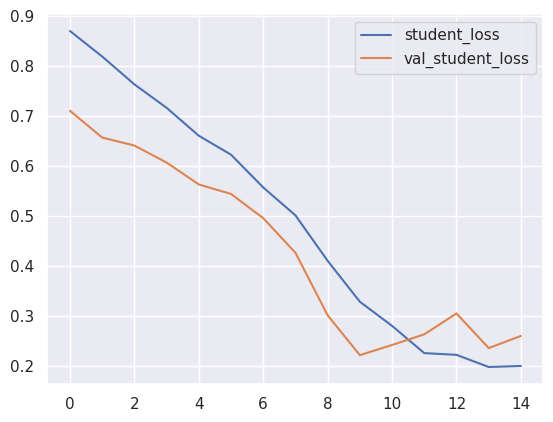

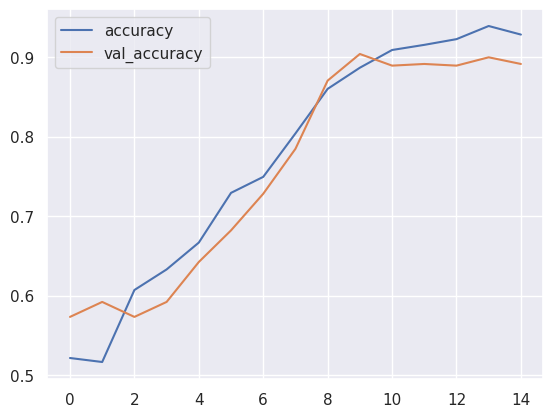

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7725
Loss for Train: 0.4912
Accuracy for Test: 0.7601
Loss for Test: 0.4311


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss_dist_deit = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss_dist_deit))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9343
Loss: 0.1549
Inference Time: 1.39s
Precision: 0.9855
Recall: 0.8395
F1-Score: 0.9067
AUC: 0.9160
MCC: 0.8630


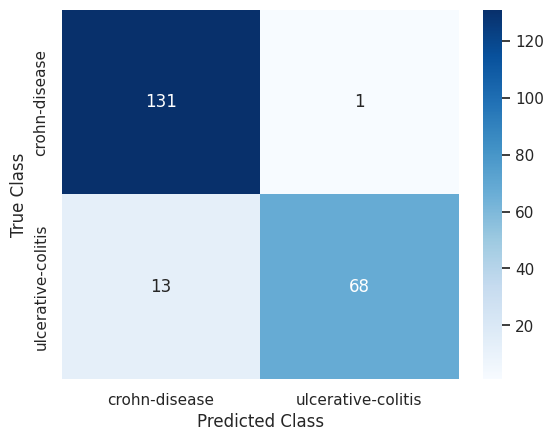

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

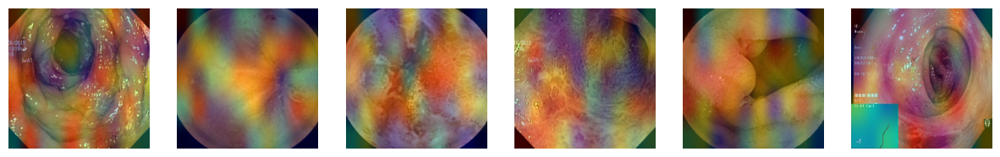

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b32.layers[-1].activation = None

  preds = model_vit_b32.predict(img_array)
  heatmap = make_gradcam_heatmap_ViT(img_array, model_vit_b32, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (5,10))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

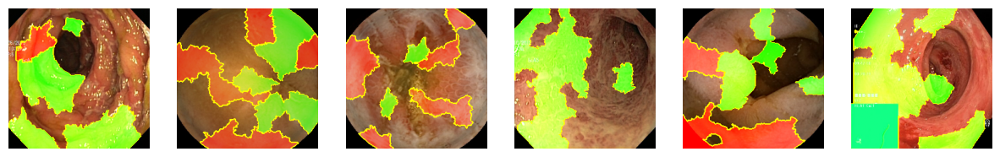

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


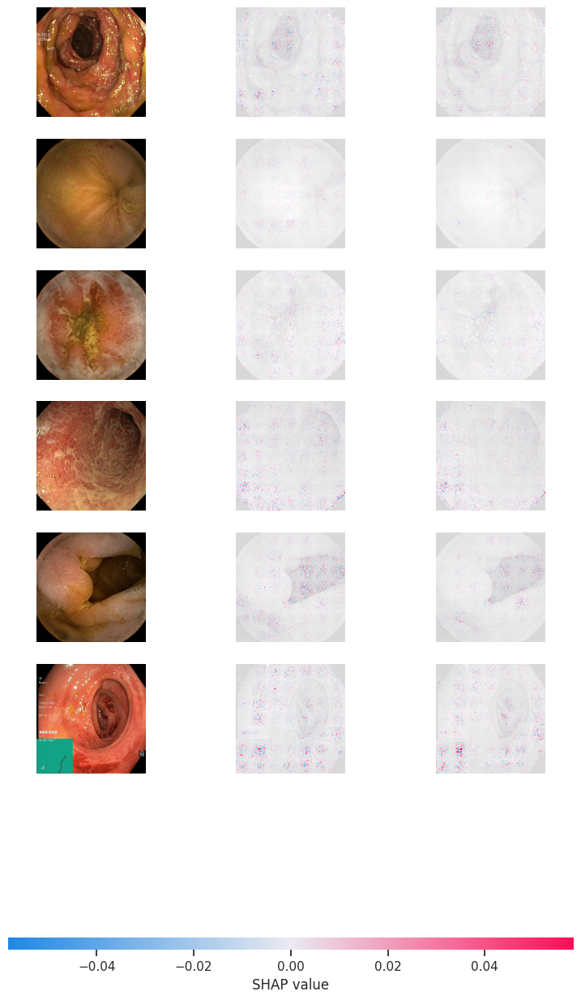

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b32, images_train_1).shap_values(image_interpretability)
shap.image_plot(shap_values, image_interpretability)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 402.52it/s]


Explaining: 100%|██████████| 32/32 [00:06<00:00,  5.19it/s]


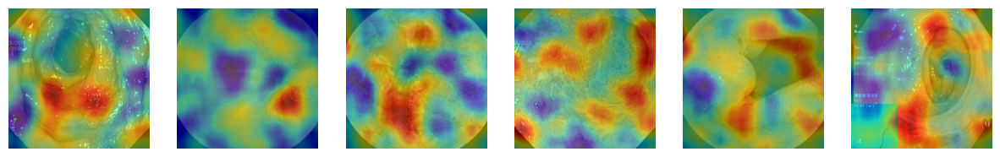

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

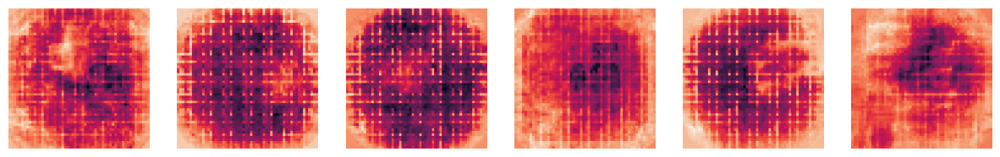

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_b32, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

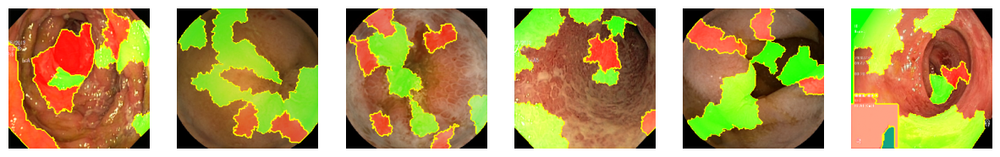

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 244.27it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.48it/s]


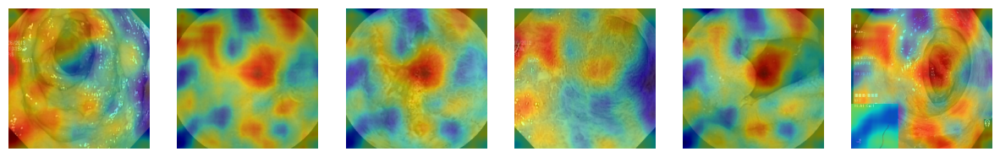

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

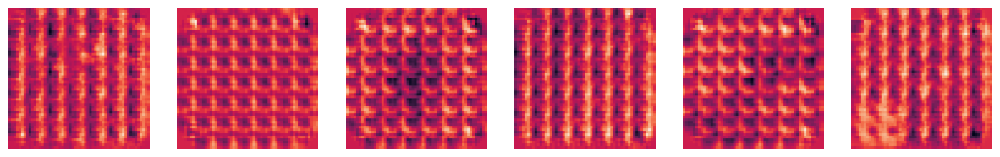

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h2>Interpretability of Second Student</h2>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

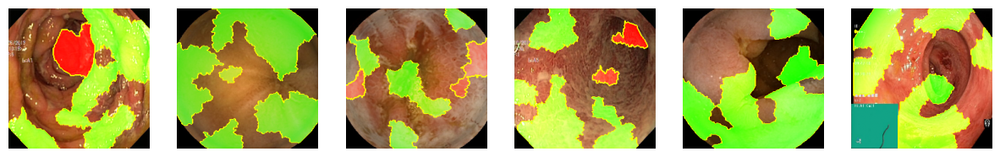

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 417.58it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.06it/s]


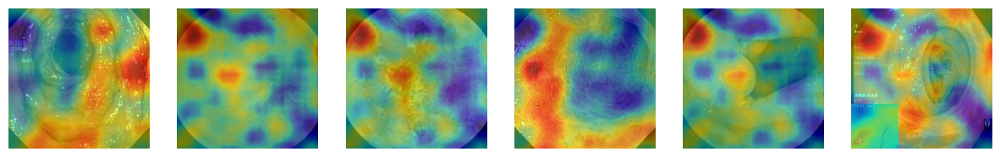

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

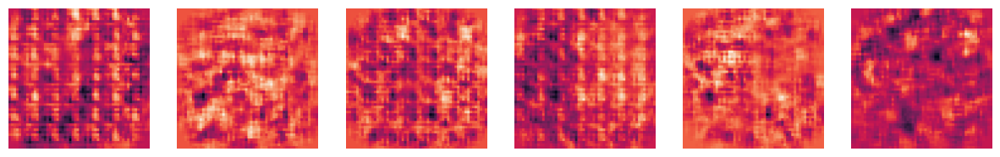

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/32

In [ ]:
vit_model_s32 = tfimm.create_model("vit_small_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_s32_preprocessing = tfimm.create_preprocessing("vit_small_patch32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s32_preprocessing(x)
x = vit_model_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s32 = Model(inputs, outputs)

In [ ]:
model_vit_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s32 = model_vit_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 25s 420ms/step - loss: 0.1428 - accuracy: 0.9440 - val_loss: 0.0437 - val_accuracy: 0.9812
Epoch 2/200
23/23 [==============================] - 7s 228ms/step - loss: 0.0057 - accuracy: 0.9971 - val_loss: 0.0036 - val_accuracy: 1.0000
Epoch 3/200
23/23 [==============================] - 5s 221ms/step - loss: 0.0053 - accuracy: 0.9986 - val_loss: 0.0108 - val_accuracy: 0.9937
Epoch 4/200
23/23 [==============================] - 8s 299ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 5s 216ms/step - loss: 6.1623e-04 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 7s 276ms/step - loss: 6.9675e-04 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 6s 223ms/step - loss: 4.7541e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_acc

<Axes: >

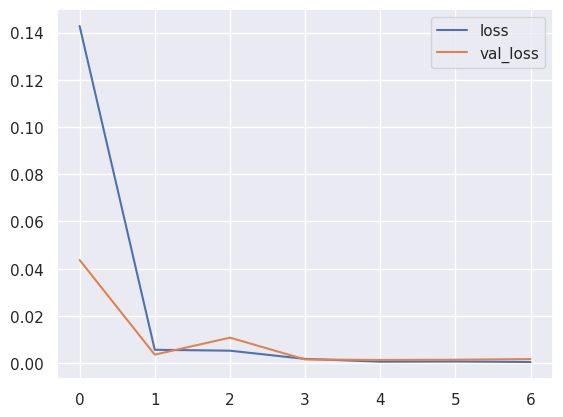

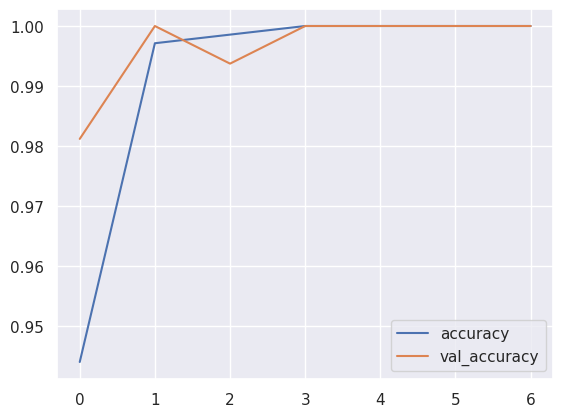

In [ ]:
model_history_s32 = pd.DataFrame(history_s32.history)
model_history_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s32['val_loss'].mean()))

Accuracy for Train: 0.9914
Loss for Train: 0.0225
Accuracy for Test: 0.9964
Loss for Test: 0.0092


In [ ]:
start = time.time()
predict_labels_ = model_vit_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s32 = np.argmax(model_vit_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s32)))

Accuracy: 1.0000
Loss: 0.0008
Inference Time: 4.01s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


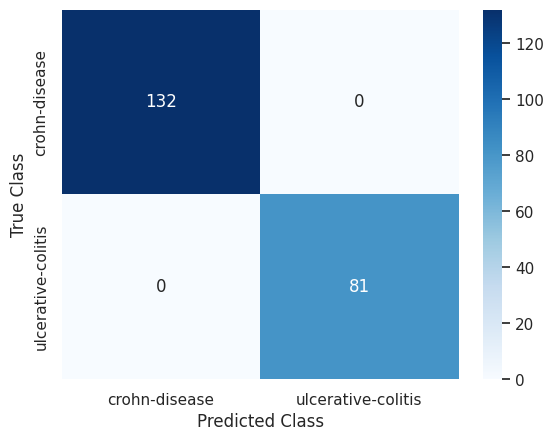

In [ ]:
conf_matrix_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 16s 282ms/step - accuracy: 0.5704 - student_loss: 1.4485 - distillation_loss: 15.2246 - val_accuracy: 0.9059 - val_student_loss: 0.6815
Epoch 2/100
23/23 [==============================] - 4s 158ms/step - accuracy: 0.6451 - student_loss: 0.9919 - distillation_loss: 12.1105 - val_accuracy: 0.6067 - val_student_loss: 0.0896
Epoch 3/100
23/23 [==============================] - 5s 214ms/step - accuracy: 0.7443 - student_loss: 0.6945 - distillation_loss: 8.9662 - val_accuracy: 0.7552 - val_student_loss: 0.0022
Epoch 4/100
23/23 [==============================] - 6s 206ms/step - accuracy: 0.8908 - student_loss: 0.3286 - distillation_loss: 5.4147 - val_accuracy: 0.9791 - val_student_loss: 0.0266
Epoch 5/100
23/23 [==============================] - 4s 152ms/step - accuracy: 0.9454 - student_loss: 0.1911 - distillation_loss: 4.0479 - val_accuracy: 0.7448 - val_student_loss: 3.5267
Epoch 6/100
23/23 [==============================] - 7s 262ms/

<Axes: >

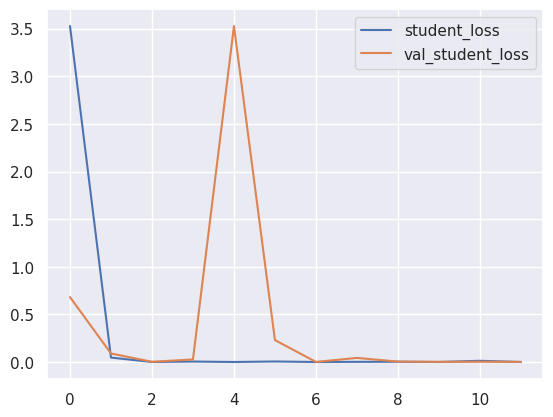

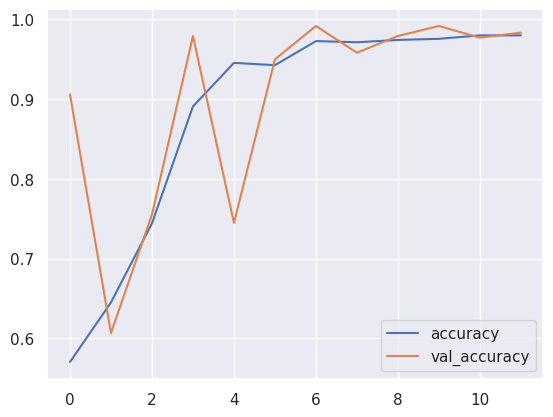

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8827
Loss for Train: 0.3002
Accuracy for Test: 0.9018
Loss for Test: 0.3842


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9859
Loss: 0.0305
Inference Time: 0.94s
Precision: 1.0000
Recall: 0.9630
F1-Score: 0.9811
AUC: 0.9815
MCC: 0.9703


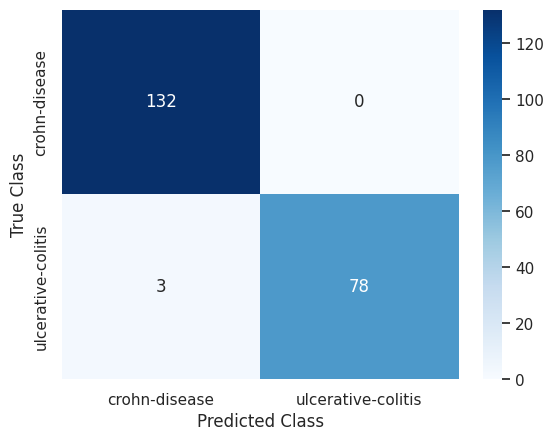

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 29s 415ms/step - accuracy: 0.5251 - student_loss: 0.8723 - distillation_loss: 0.9005 - val_accuracy: 0.5586 - val_student_loss: 0.6916 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 16s 351ms/step - accuracy: 0.5453 - student_loss: 0.7933 - distillation_loss: 0.7830 - val_accuracy: 0.5690 - val_student_loss: 0.6515 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 17s 356ms/step - accuracy: 0.5848 - student_loss: 0.7453 - distillation_loss: 0.7293 - val_accuracy: 0.5690 - val_student_loss: 0.6365 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 19s 379ms/step - accuracy: 0.6307 - student_loss: 0.7004 - distillation_loss: 0.7115 - val_accuracy: 0.5753 - val_student_loss: 0.6099 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 17s 361ms/step - accuracy: 0.6638 - student_loss: 0

<Axes: >

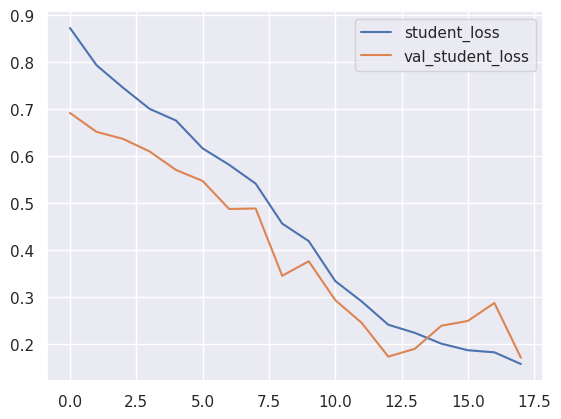

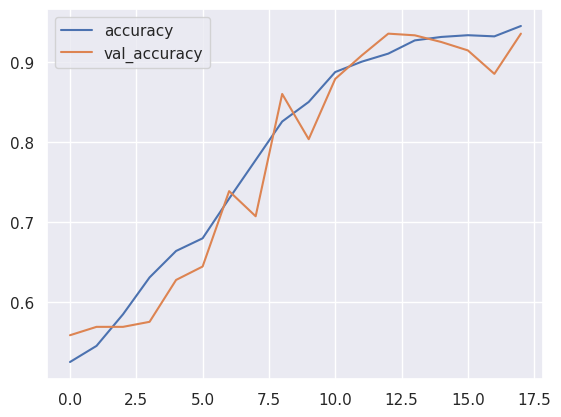

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7876
Loss for Train: 0.4567
Accuracy for Test: 0.7759
Loss for Test: 0.4030


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9484
Loss: 0.1330
Inference Time: 1.24s
Precision: 0.9861
Recall: 0.8765
F1-Score: 0.9281
AUC: 0.9345
MCC: 0.8918


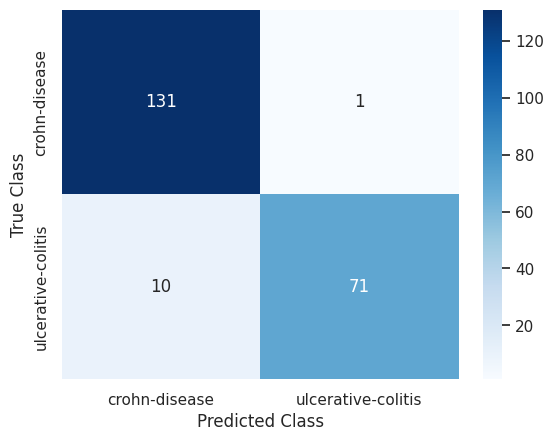

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

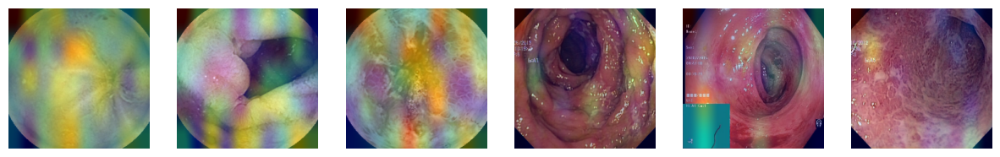

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s32.layers[-1].activation = None

  preds = model_vit_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (5,10))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

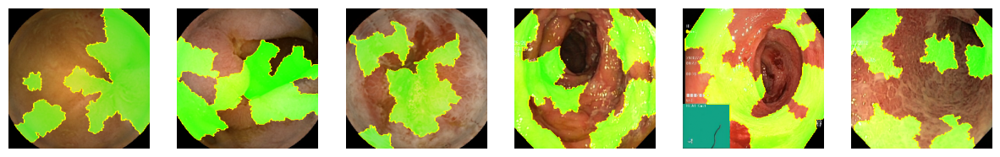

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


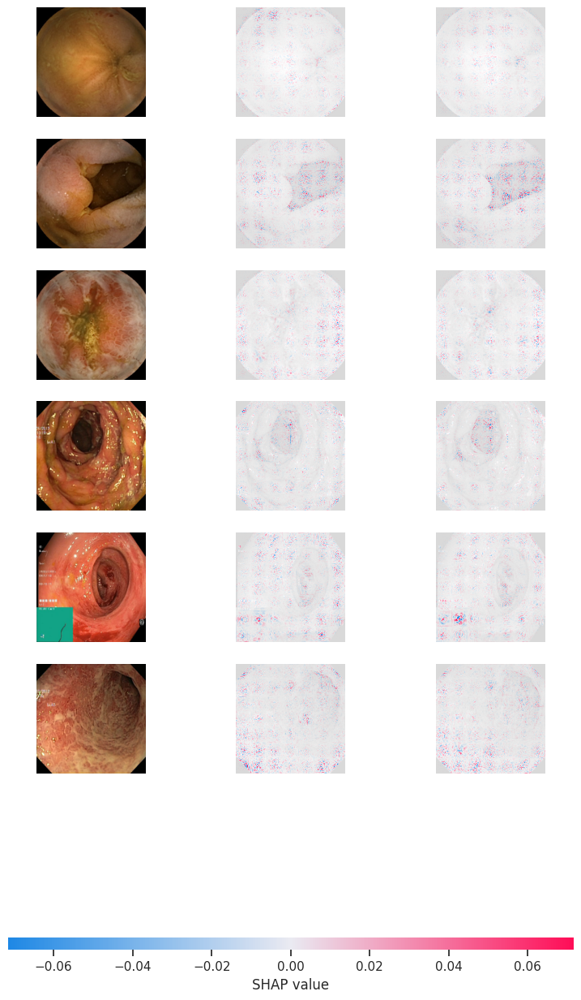

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s32, images_train_1).shap_values(image_interpretability)
shap.image_plot(shap_values, image_interpretability)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 374.69it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.67it/s]


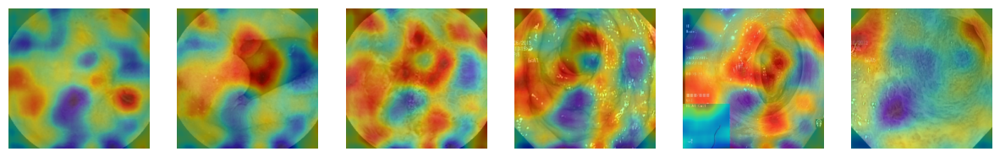

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

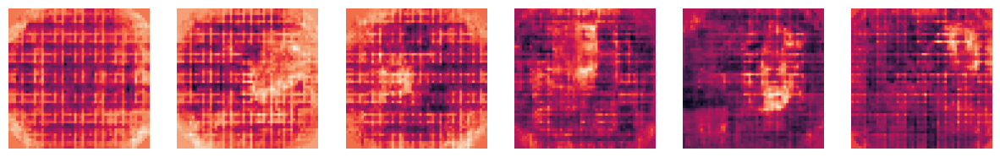

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_s32, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

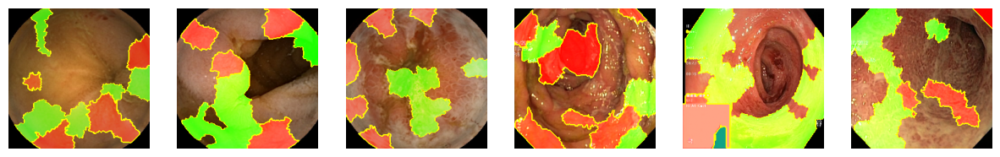

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 266.27it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.03it/s]


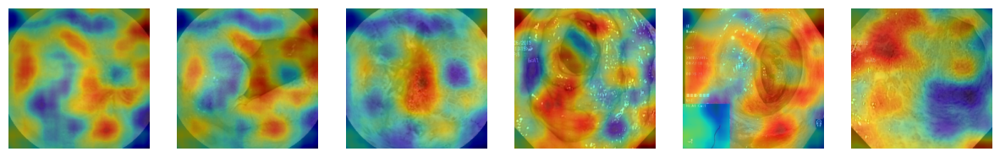

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

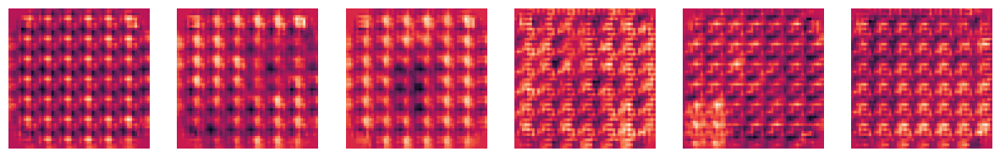

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

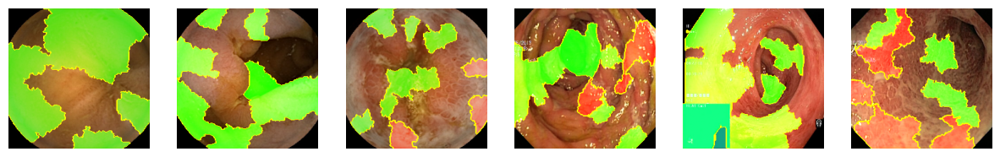

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 407.80it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 11.90it/s]


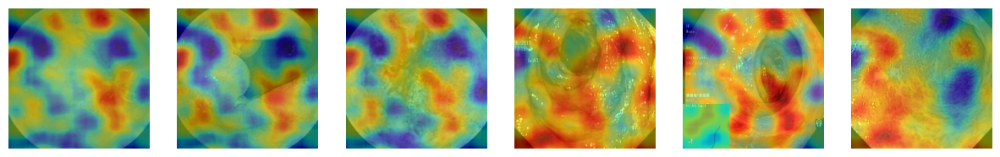

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

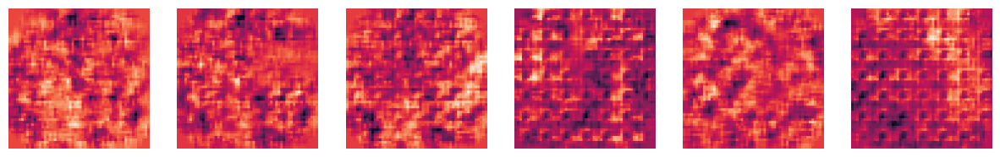

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_B/16

In [ ]:
vit_model_16 = tfimm.create_model("vit_base_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_16_preprocessing = tfimm.create_preprocessing("vit_base_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_16_preprocessing(x)
x = vit_model_16.call(x)
x = layers.Dense(1000, activation="relu")(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_b16 = Model(inputs, outputs)

In [ ]:
model_vit_b16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_b16 = model_vit_b16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 52s 2s/step - loss: 0.1100 - accuracy: 0.9598 - val_loss: 3.9763e-04 - val_accuracy: 1.0000
Epoch 2/200
23/23 [==============================] - 38s 2s/step - loss: 0.0028 - accuracy: 0.9986 - val_loss: 4.0220e-04 - val_accuracy: 1.0000
Epoch 3/200
23/23 [==============================] - 37s 2s/step - loss: 3.8915e-04 - accuracy: 1.0000 - val_loss: 1.2382e-04 - val_accuracy: 1.0000
Epoch 4/200
23/23 [==============================] - 37s 2s/step - loss: 1.1833e-04 - accuracy: 1.0000 - val_loss: 1.3688e-04 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 37s 2s/step - loss: 8.3182e-05 - accuracy: 1.0000 - val_loss: 1.8937e-04 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 37s 2s/step - loss: 6.6706e-05 - accuracy: 1.0000 - val_loss: 1.6669e-04 - val_accuracy: 1.0000


<Axes: >

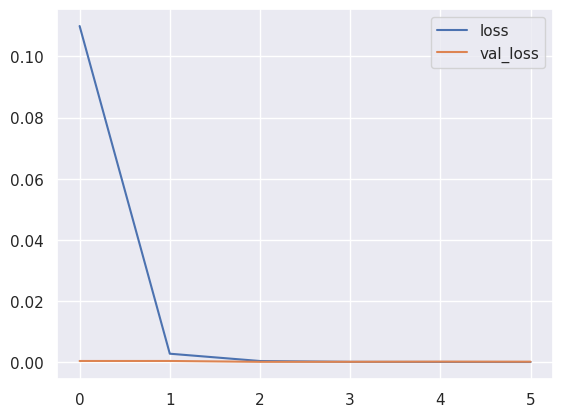

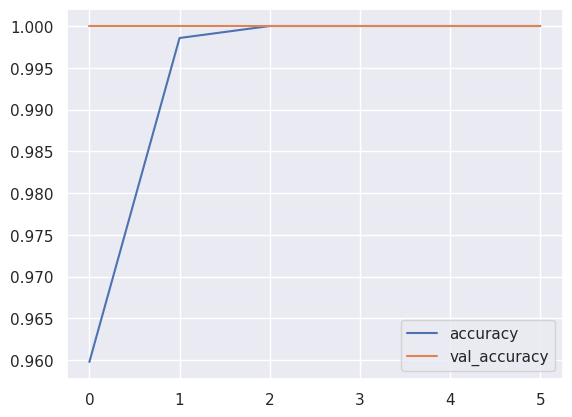

In [ ]:
model_history_b16 = pd.DataFrame(history_b16.history)
model_history_b16.loc[:, ['loss', 'val_loss']].plot()
model_history_b16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_b16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_b16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_b16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_b16['val_loss'].mean()))

Accuracy for Train: 0.9931
Loss for Train: 0.0189
Accuracy for Test: 1.0000
Loss for Test: 0.0002


In [ ]:
start = time.time()
predict_labels_ = model_vit_b16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_b16 = np.argmax(model_vit_b16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_b16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_b16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_b16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_b16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_b16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_b16)))

Accuracy: 1.0000
Loss: 0.0003
Inference Time: 5.23s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


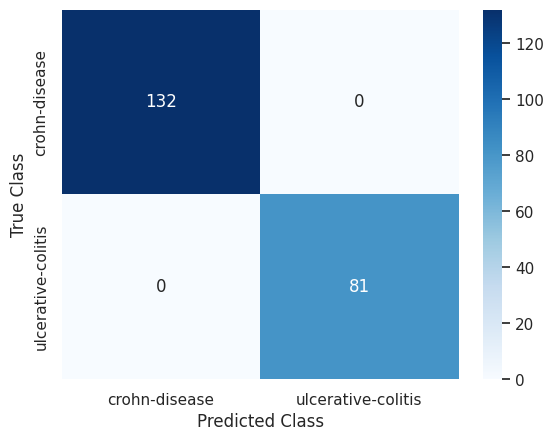

In [ ]:
conf_matrix_b16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_b16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_b16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ViT = Distiller(student=student_model_2, teacher=model_vit_b16)

distillation_ViT.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history_ViT = distillation_ViT.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 22s 558ms/step - accuracy: 0.6983 - student_loss: 1.0123 - distillation_loss: 20.2128 - val_accuracy: 0.7364 - val_student_loss: 0.1603
Epoch 2/100
23/23 [==============================] - 13s 555ms/step - accuracy: 0.8376 - student_loss: 0.6233 - distillation_loss: 11.1526 - val_accuracy: 0.9603 - val_student_loss: 0.3477
Epoch 3/100
23/23 [==============================] - 13s 541ms/step - accuracy: 0.9598 - student_loss: 0.1829 - distillation_loss: 5.4609 - val_accuracy: 0.9623 - val_student_loss: 0.1582
Epoch 4/100
23/23 [==============================] - 13s 542ms/step - accuracy: 0.9641 - student_loss: 0.1194 - distillation_loss: 5.0644 - val_accuracy: 0.9414 - val_student_loss: 0.2793
Epoch 5/100
23/23 [==============================] - 14s 574ms/step - accuracy: 0.9612 - student_loss: 0.1208 - distillation_loss: 5.2350 - val_accuracy: 0.9874 - val_student_loss: 0.0291
Epoch 6/100
23/23 [==============================] - 14s 5

<Axes: >

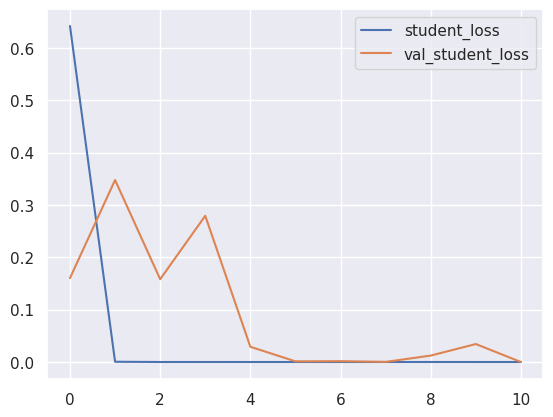

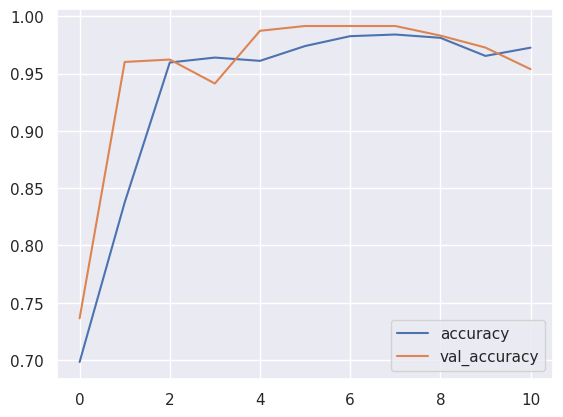

In [ ]:
distiller_history = pd.DataFrame(distillation_history_ViT.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9347
Loss for Train: 0.0584
Accuracy for Test: 0.9521
Loss for Test: 0.0931


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_ViT.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_ViT.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9437
Loss: 0.1201
Inference Time: 1.96s
Precision: 0.8710
Recall: 1.0000
F1-Score: 0.9310
AUC: 0.9545
MCC: 0.8898


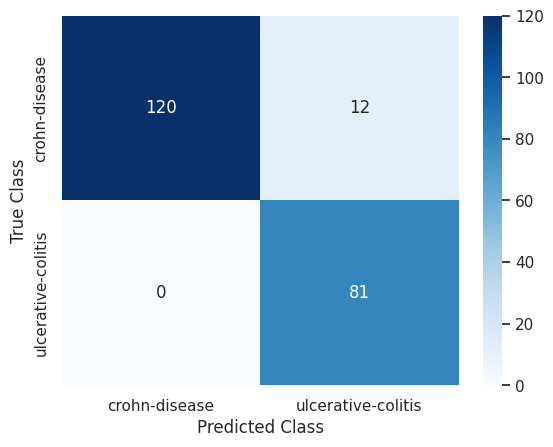

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_ViT.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 46s 823ms/step - accuracy: 0.5467 - student_loss: 0.8956 - distillation_loss: 0.8287 - val_accuracy: 0.5649 - val_student_loss: 0.6946 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 37s 785ms/step - accuracy: 0.5898 - student_loss: 0.7806 - distillation_loss: 0.7545 - val_accuracy: 0.5649 - val_student_loss: 0.6632 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 35s 751ms/step - accuracy: 0.5999 - student_loss: 0.7542 - distillation_loss: 0.7604 - val_accuracy: 0.5586 - val_student_loss: 0.6337 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 37s 792ms/step - accuracy: 0.6408 - student_loss: 0.7383 - distillation_loss: 0.6956 - val_accuracy: 0.5690 - val_student_loss: 0.6109 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 36s 771ms/step - accuracy: 0.6652 - student_loss: 0

<Axes: >

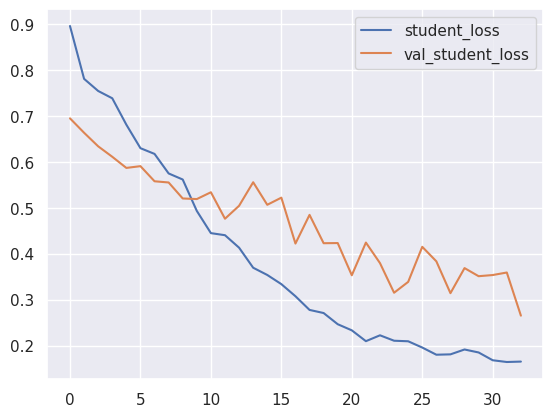

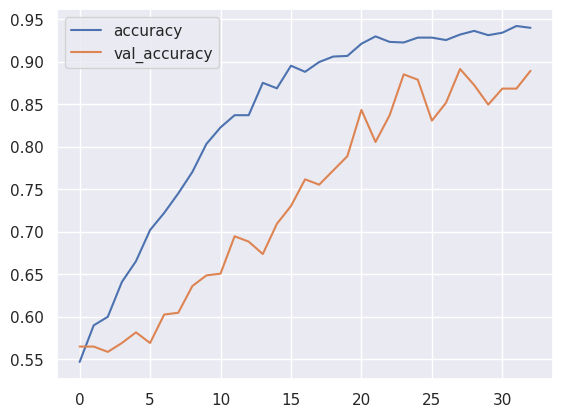

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8367
Loss for Train: 0.3848
Accuracy for Test: 0.7361
Loss for Test: 0.4667


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.8920
Loss: 0.2842
Inference Time: 1.39s
Precision: 1.0000
Recall: 0.7160
F1-Score: 0.8345
AUC: 0.8580
MCC: 0.7809


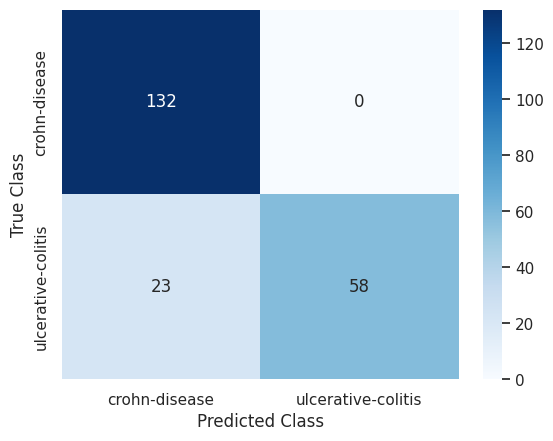

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

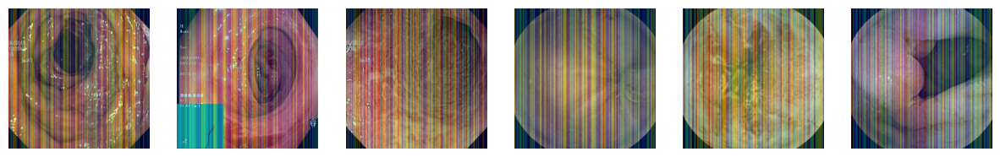

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability[:6], axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b16.layers[-1].activation = None

  preds = model_vit_b16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_b16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

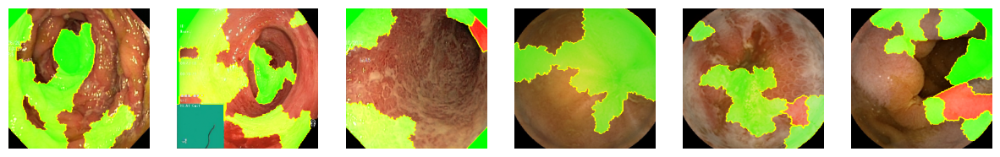

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


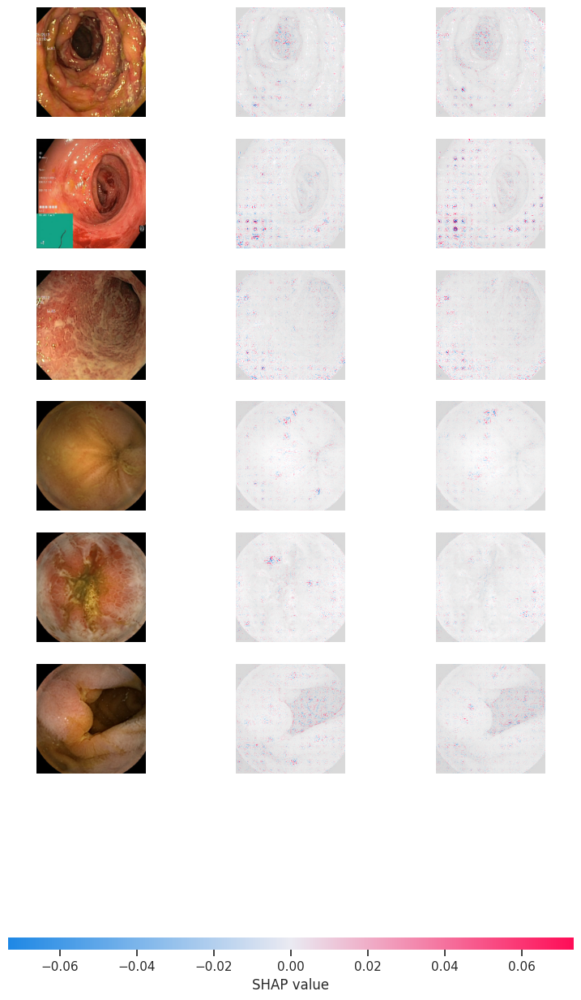

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b16, images_train_1).shap_values(image_interpretability)
shap.image_plot(shap_values, image_interpretability)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 434.96it/s]


Explaining: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s]


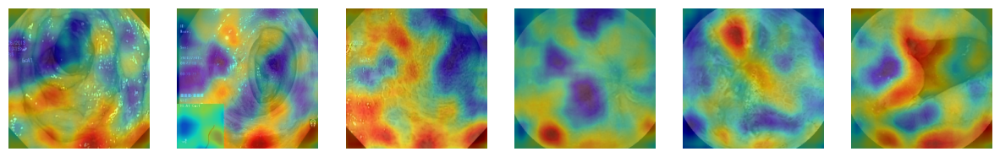

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

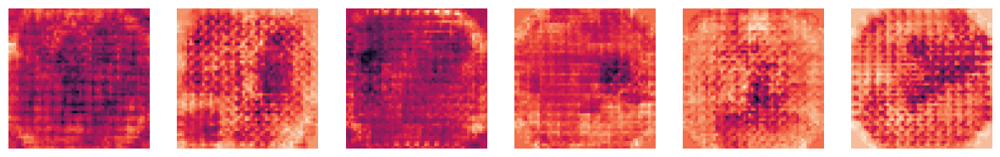

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_b16, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

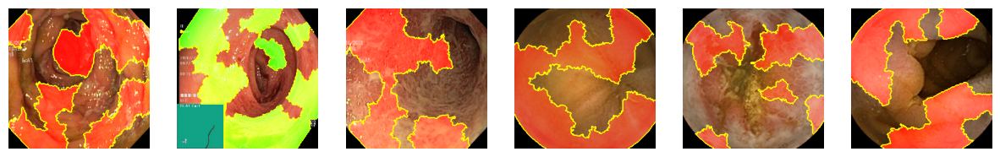

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 256.80it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.96it/s]


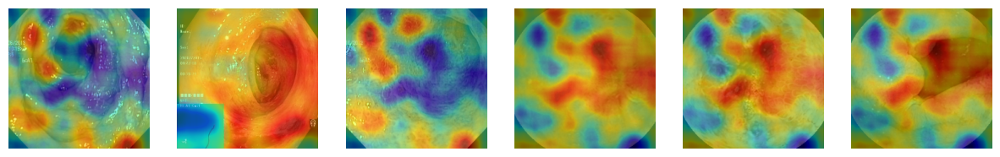

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

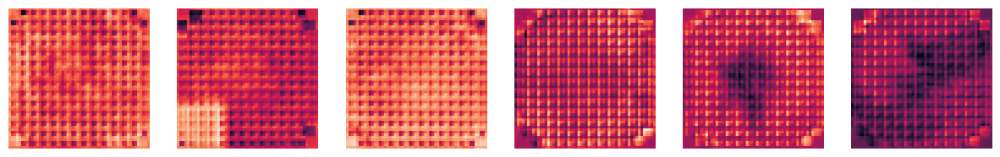

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

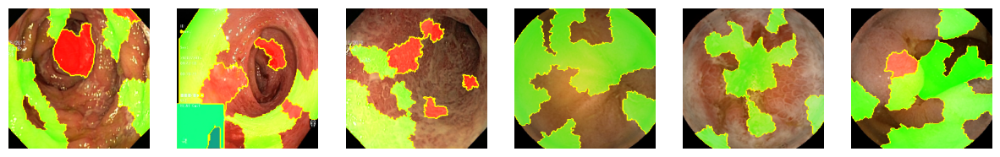

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1,6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_ViT.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_ViT, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 247.44it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.87it/s]


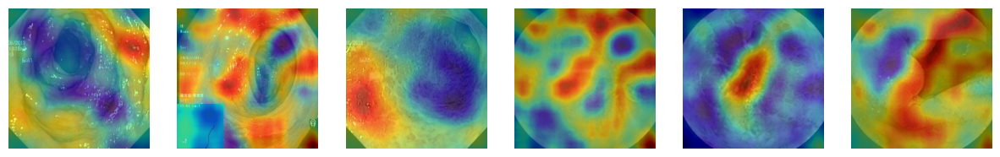

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivy</h3>

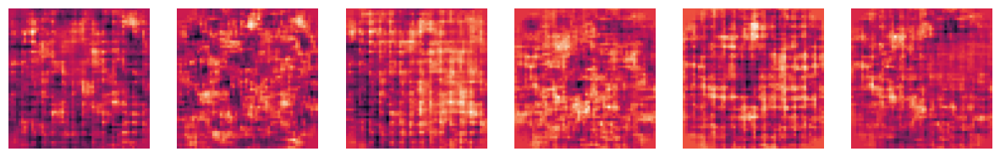

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_ViT, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/16

In [12]:
vit_model_s16 = tfimm.create_model("vit_small_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_s16_preprocessing = tfimm.create_preprocessing("vit_small_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s16_preprocessing(x)
x = vit_model_s16.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s16 = Model(inputs, outputs)

In [13]:
model_vit_s16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [14]:
model_vit_s16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [15]:
history_s16 = model_vit_s16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 30s 687ms/step - loss: 0.1921 - accuracy: 0.9310 - val_loss: 0.0114 - val_accuracy: 0.9979
Epoch 2/200
23/23 [==============================] - 14s 592ms/step - loss: 0.0087 - accuracy: 0.9971 - val_loss: 0.0084 - val_accuracy: 0.9979
Epoch 3/200
23/23 [==============================] - 14s 593ms/step - loss: 0.0043 - accuracy: 0.9986 - val_loss: 0.0087 - val_accuracy: 0.9958
Epoch 4/200
23/23 [==============================] - 15s 622ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0040 - val_accuracy: 0.9979
Epoch 5/200
23/23 [==============================] - 14s 610ms/step - loss: 4.2739e-04 - accuracy: 1.0000 - val_loss: 0.0045 - val_accuracy: 0.9979
Epoch 6/200
23/23 [==============================] - 15s 612ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 0.9979


<Axes: >

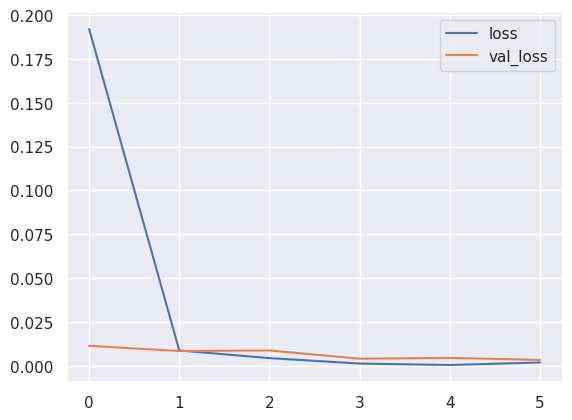

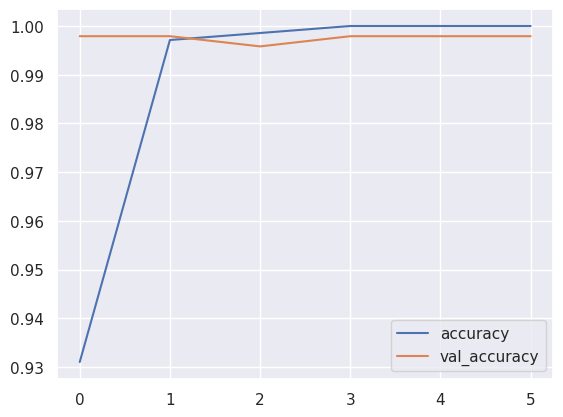

In [16]:
model_history_s16 = pd.DataFrame(history_s16.history)
model_history_s16.loc[:, ['loss', 'val_loss']].plot()
model_history_s16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [17]:
print('Accuracy for Train: {:.4f}'.format(model_history_s16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s16['val_loss'].mean()))

Accuracy for Train: 0.9878
Loss for Train: 0.0348
Accuracy for Test: 0.9976
Loss for Test: 0.0067


In [18]:
start = time.time()
predict_labels_ = model_vit_s16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s16 = np.argmax(model_vit_s16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s16)))

Accuracy: 1.0000
Loss: 0.0007
Inference Time: 4.54s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


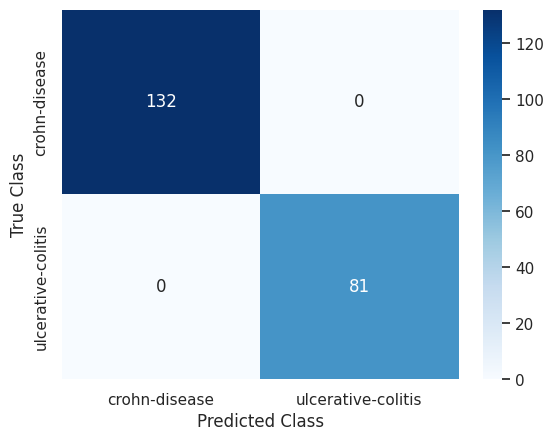

In [19]:
conf_matrix_s16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [20]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [21]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [22]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 17s 300ms/step - accuracy: 0.6049 - student_loss: 1.4747 - distillation_loss: 14.4556 - val_accuracy: 0.8096 - val_student_loss: 0.2196
Epoch 2/100
23/23 [==============================] - 6s 258ms/step - accuracy: 0.8003 - student_loss: 0.5476 - distillation_loss: 8.1155 - val_accuracy: 0.9686 - val_student_loss: 0.1359
Epoch 3/100
23/23 [==============================] - 8s 302ms/step - accuracy: 0.9555 - student_loss: 0.1703 - distillation_loss: 4.5466 - val_accuracy: 0.8912 - val_student_loss: 0.8179
Epoch 4/100
23/23 [==============================] - 6s 259ms/step - accuracy: 0.9540 - student_loss: 0.1383 - distillation_loss: 4.2455 - val_accuracy: 0.9456 - val_student_loss: 0.2767
Epoch 5/100
23/23 [==============================] - 8s 317ms/step - accuracy: 0.9727 - student_loss: 0.0648 - distillation_loss: 3.3008 - val_accuracy: 0.9833 - val_student_loss: 0.0306
Epoch 6/100
23/23 [==============================] - 7s 257ms/s

<Axes: >

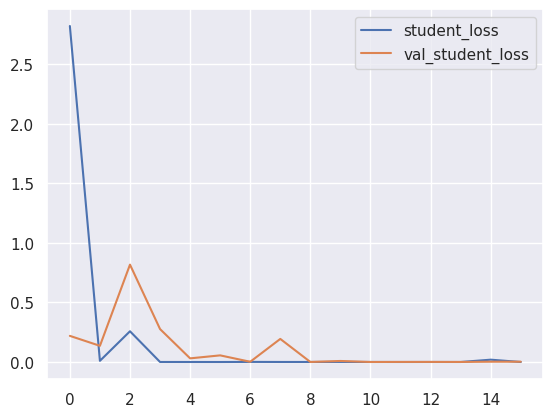

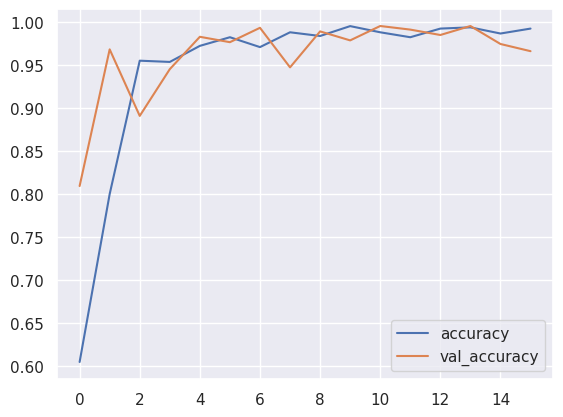

In [23]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [24]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9467
Loss for Train: 0.1946
Accuracy for Test: 0.9622
Loss for Test: 0.1093


In [25]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9671
Loss: 0.1367
Inference Time: 1.33s
Precision: 1.0000
Recall: 0.9136
F1-Score: 0.9548
AUC: 0.9568
MCC: 0.9314


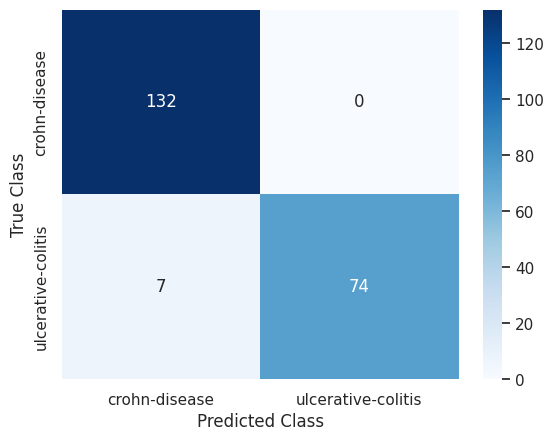

In [26]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [27]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [28]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [29]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [30]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 34s 548ms/step - accuracy: 0.4914 - student_loss: 1.0190 - distillation_loss: 0.7905 - val_accuracy: 0.5565 - val_student_loss: 0.6588 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 23s 497ms/step - accuracy: 0.5805 - student_loss: 0.7937 - distillation_loss: 0.7062 - val_accuracy: 0.5921 - val_student_loss: 0.6401 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 24s 526ms/step - accuracy: 0.6020 - student_loss: 0.7552 - distillation_loss: 0.7092 - val_accuracy: 0.5732 - val_student_loss: 0.6380 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 23s 501ms/step - accuracy: 0.6307 - student_loss: 0.7407 - distillation_loss: 0.6878 - val_accuracy: 0.5921 - val_student_loss: 0.6094 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 24s 495ms/step - accuracy: 0.6171 - student_loss: 0

<Axes: >

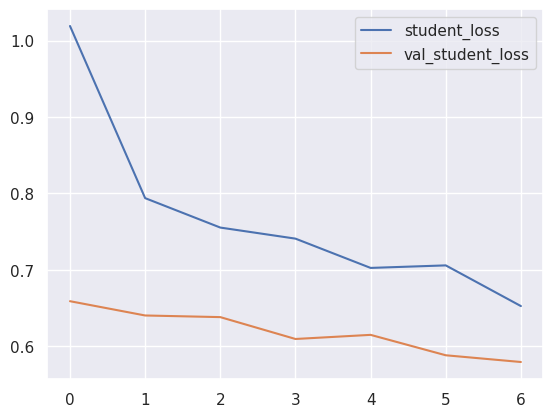

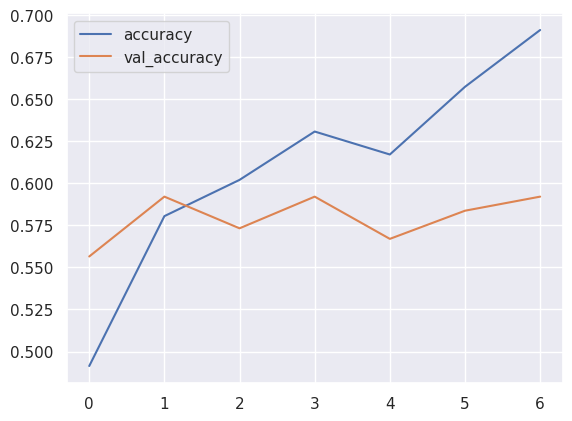

In [31]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [32]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.6100
Loss for Train: 0.7670
Accuracy for Test: 0.5795
Loss for Test: 0.6183


In [33]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.6291
Loss: 0.5473
Inference Time: 1.08s
Precision: 1.0000
Recall: 0.0247
F1-Score: 0.0482
AUC: 0.5123
MCC: 0.1243


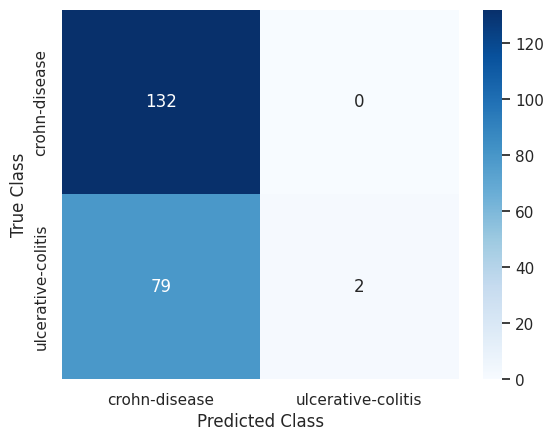

In [34]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [35]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

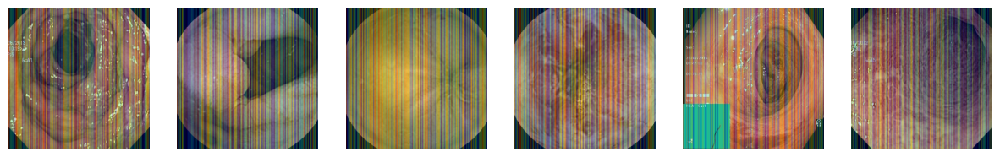

In [36]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s16.layers[-1].activation = None

  preds = model_vit_s16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

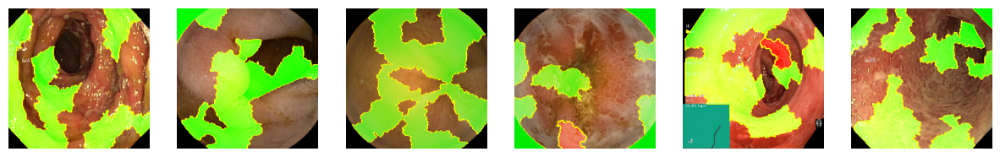

In [37]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


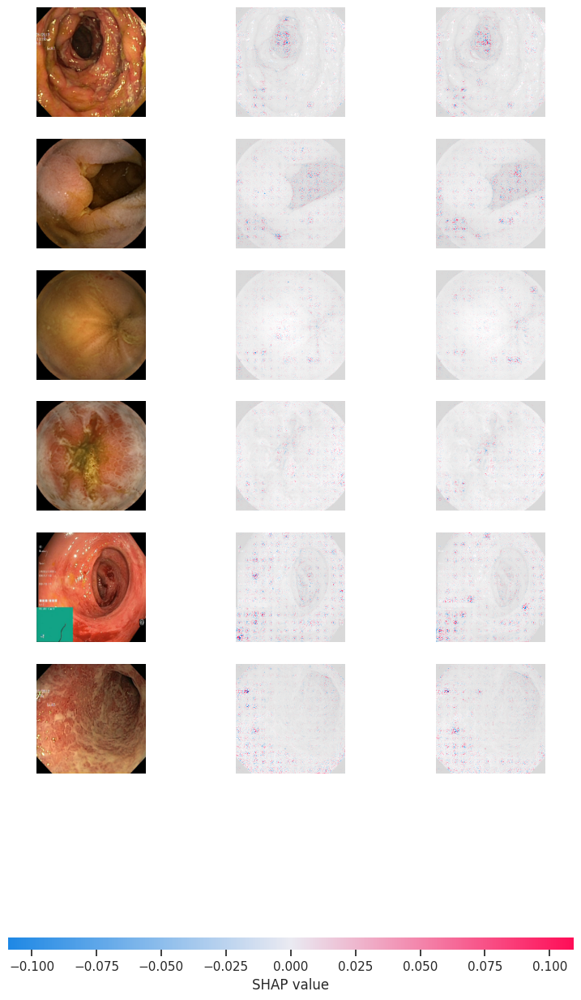

In [38]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s16, images_train_1).shap_values(image_interpretability)
shap.image_plot(shap_values, image_interpretability)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [39]:
model_rise = RISE(1000, 8, 0.5, model_vit_s16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 298.24it/s]


Explaining: 100%|██████████| 32/32 [00:07<00:00,  4.35it/s]


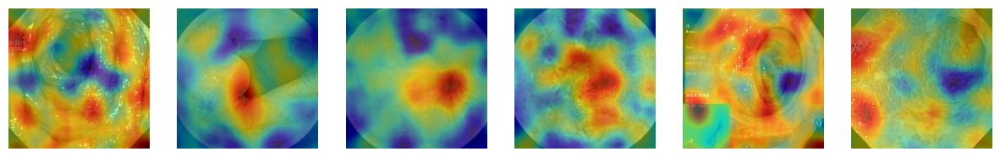

In [40]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

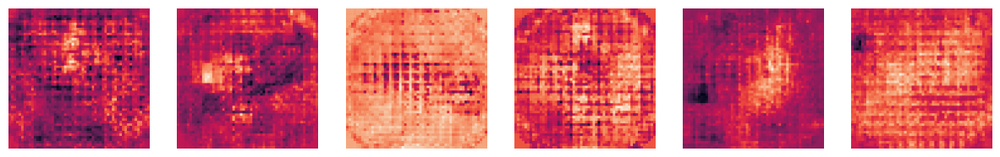

In [41]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_s16, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

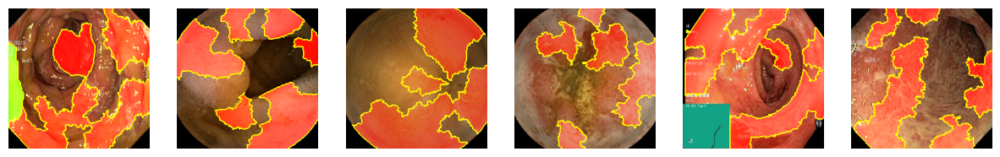

In [42]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [43]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 422.66it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  7.37it/s]


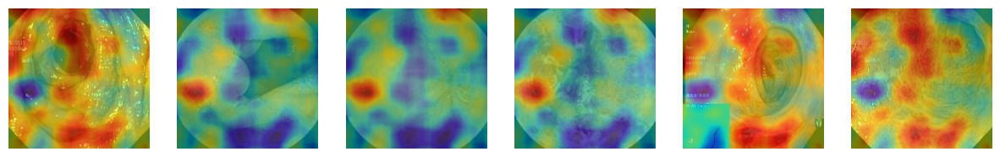

In [44]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

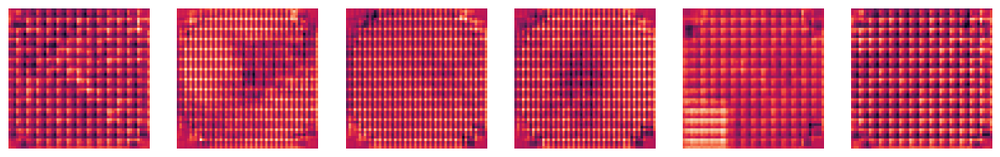

In [45]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

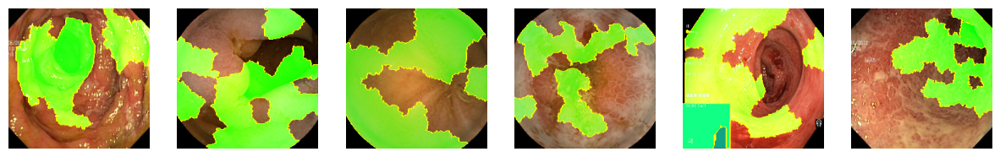

In [46]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [47]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 431.83it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 11.17it/s]


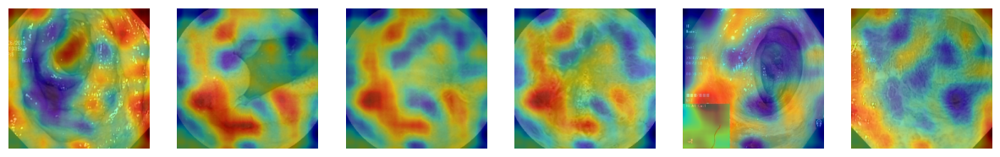

In [48]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

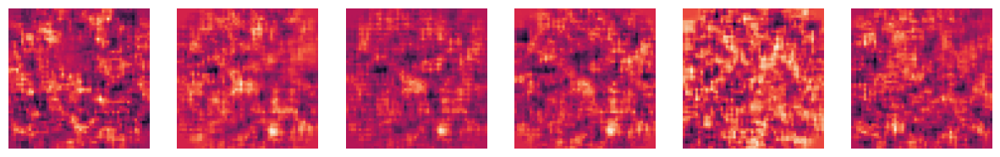

In [49]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# R26+S/32

In [ ]:
vit_model_hybrid_s32 = tfimm.create_model("vit_small_r26_s32_224_in21k", pretrained=True, nb_classes=0)
vit_model_hybrid_s32_preprocessing = tfimm.create_preprocessing("vit_small_r26_s32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_hybrid_s32_preprocessing(x)
x = vit_model_hybrid_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_hybrid_s32 = Model(inputs, outputs)

In [ ]:
model_vit_hybrid_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_hybrid_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_hybrid_s32 = model_vit_hybrid_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 60s 1s/step - loss: 0.3742 - accuracy: 0.8477 - val_loss: 0.0102 - val_accuracy: 0.9979
Epoch 2/200
23/23 [==============================] - 17s 723ms/step - loss: 0.0102 - accuracy: 0.9971 - val_loss: 0.0060 - val_accuracy: 0.9979
Epoch 3/200
23/23 [==============================] - 17s 721ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0028 - val_accuracy: 1.0000
Epoch 4/200
23/23 [==============================] - 16s 691ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 17s 701ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 16s 701ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 18s 751ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.0020 - val_accuracy: 1.

<Axes: >

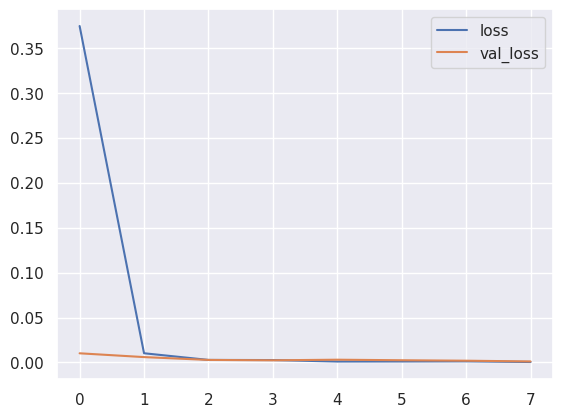

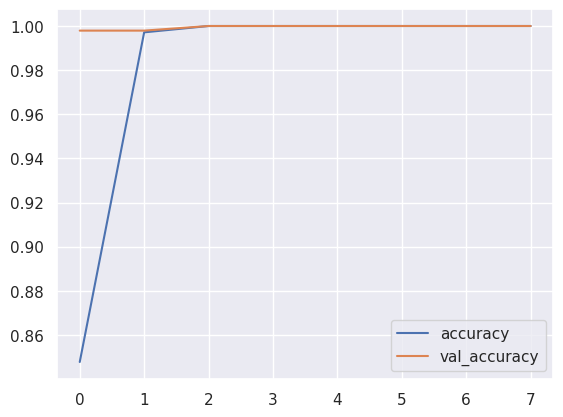

In [ ]:
model_history_hybrid_s32 = pd.DataFrame(history_hybrid_s32.history)
model_history_hybrid_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_s32['val_loss'].mean()))

Accuracy for Train: 0.9806
Loss for Train: 0.0492
Accuracy for Test: 0.9995
Loss for Test: 0.0038


In [ ]:
start = time.time()
predict_labels_ = model_vit_hybrid_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_s32 = np.argmax(model_vit_hybrid_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_s32)))

Accuracy: 1.0000
Loss: 0.0014
Inference Time: 6.15s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


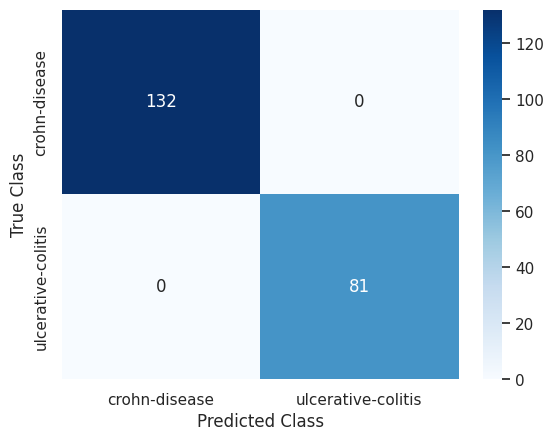

In [ ]:
conf_matrix_hybrid_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_hybrid_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_hybrid_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_hybrid_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 23s 377ms/step - accuracy: 0.6049 - student_loss: 1.1496 - distillation_loss: 11.4342 - val_accuracy: 0.7678 - val_student_loss: 0.4404
Epoch 2/100
23/23 [==============================] - 7s 285ms/step - accuracy: 0.6825 - student_loss: 0.8562 - distillation_loss: 9.3878 - val_accuracy: 0.8745 - val_student_loss: 1.7642
Epoch 3/100
23/23 [==============================] - 8s 307ms/step - accuracy: 0.9009 - student_loss: 0.2828 - distillation_loss: 4.6981 - val_accuracy: 0.9707 - val_student_loss: 0.2100
Epoch 4/100
23/23 [==============================] - 8s 341ms/step - accuracy: 0.9066 - student_loss: 0.2675 - distillation_loss: 4.0378 - val_accuracy: 0.9142 - val_student_loss: 0.0924
Epoch 5/100
23/23 [==============================] - 9s 351ms/step - accuracy: 0.9526 - student_loss: 0.1313 - distillation_loss: 3.2462 - val_accuracy: 0.9874 - val_student_loss: 0.2107
Epoch 6/100
23/23 [==============================] - 9s 351ms/s

<Axes: >

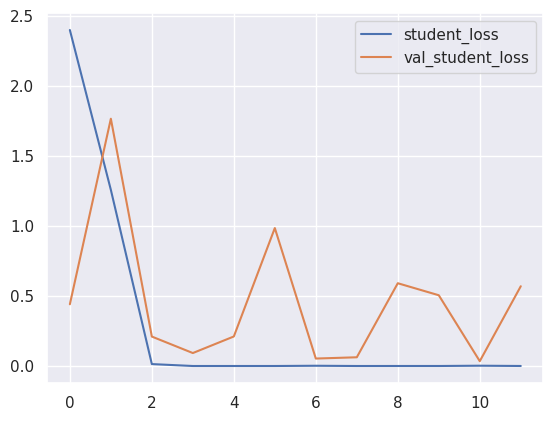

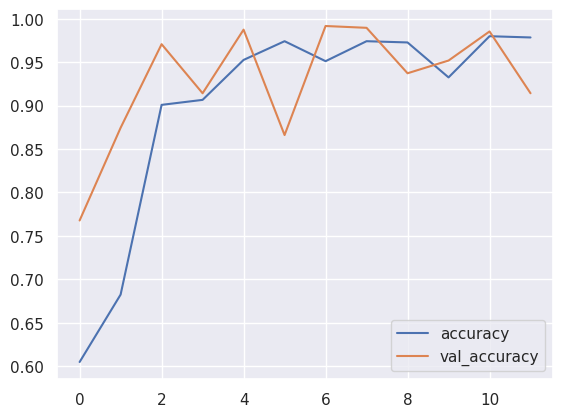

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9009
Loss for Train: 0.3060
Accuracy for Test: 0.9292
Loss for Test: 0.4597


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9202
Loss: 0.2733
Inference Time: 1.27s
Precision: 1.0000
Recall: 0.7901
F1-Score: 0.8828
AUC: 0.8951
MCC: 0.8366


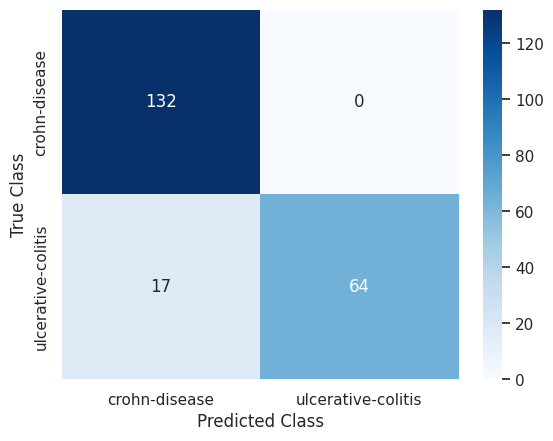

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_hybrid_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 37s 527ms/step - accuracy: 0.5503 - student_loss: 0.9098 - distillation_loss: 0.7675 - val_accuracy: 0.5669 - val_student_loss: 0.6667 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 22s 469ms/step - accuracy: 0.5632 - student_loss: 0.7986 - distillation_loss: 0.7186 - val_accuracy: 0.5649 - val_student_loss: 0.6542 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 24s 501ms/step - accuracy: 0.6272 - student_loss: 0.7082 - distillation_loss: 0.6604 - val_accuracy: 0.5586 - val_student_loss: 0.6365 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 23s 483ms/step - accuracy: 0.7062 - student_loss: 0.6174 - distillation_loss: 0.6477 - val_accuracy: 0.6046 - val_student_loss: 0.5566 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 24s 515ms/step - accuracy: 0.7320 - student_loss: 0

<Axes: >

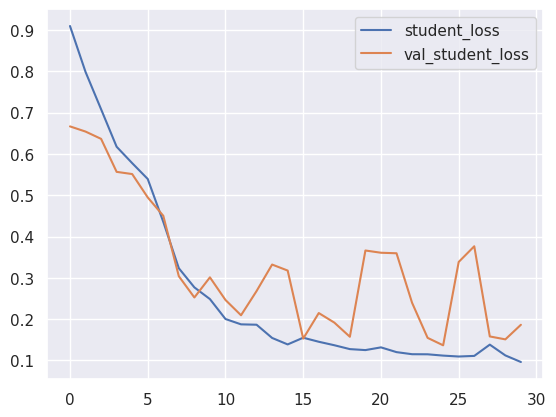

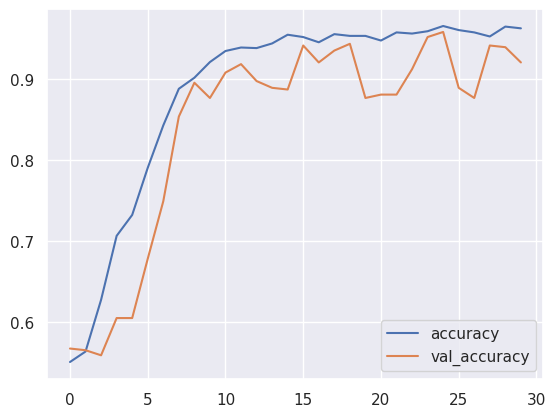

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8859
Loss for Train: 0.2717
Accuracy for Test: 0.8407
Loss for Test: 0.3261


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9437
Loss: 0.1396
Inference Time: 1.01s
Precision: 1.0000
Recall: 0.8519
F1-Score: 0.9200
AUC: 0.9259
MCC: 0.8837


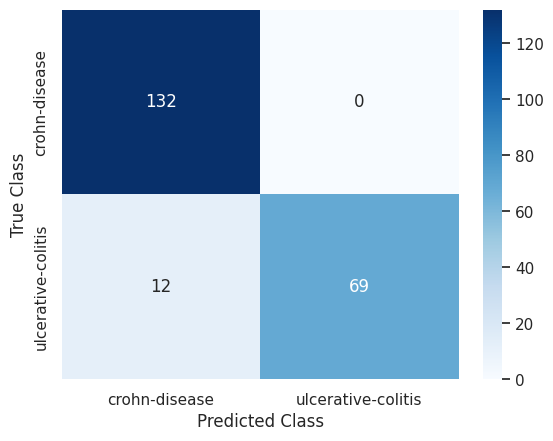

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

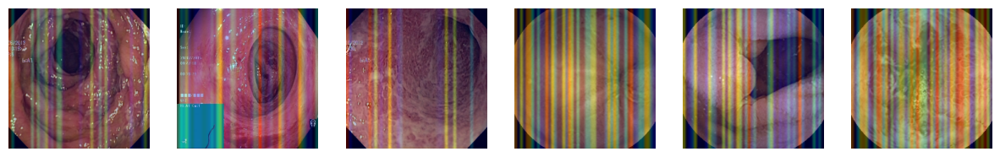

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_hybrid_s32.layers[-1].activation = None

  preds = model_vit_hybrid_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_hybrid_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

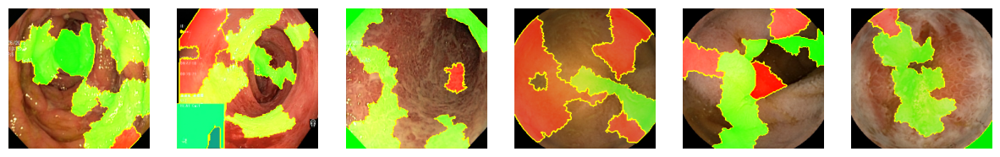

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_hybrid_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


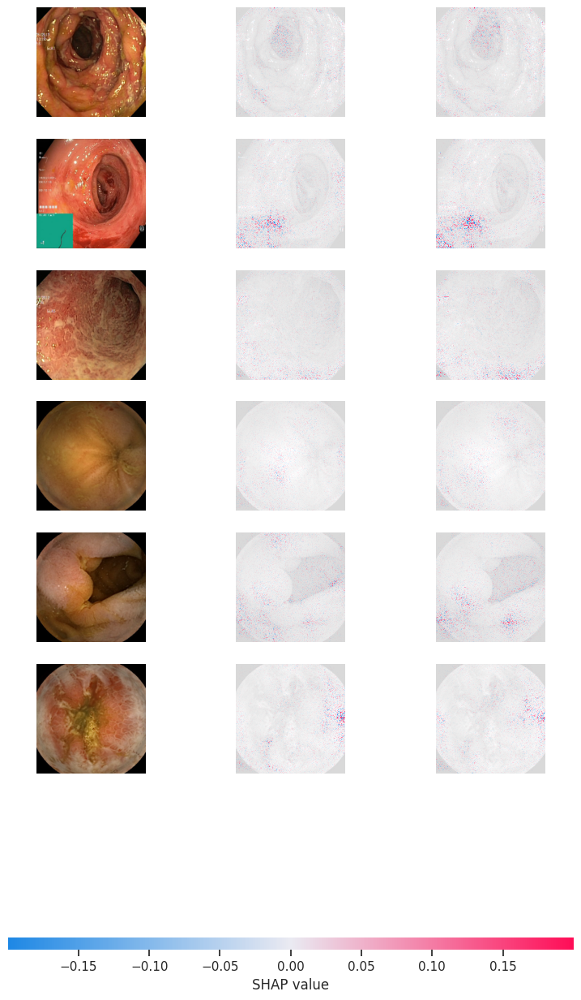

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_hybrid_s32, images_train_1).shap_values(image_interpretability)
shap.image_plot(shap_values, image_interpretability)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_hybrid_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 385.74it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s]


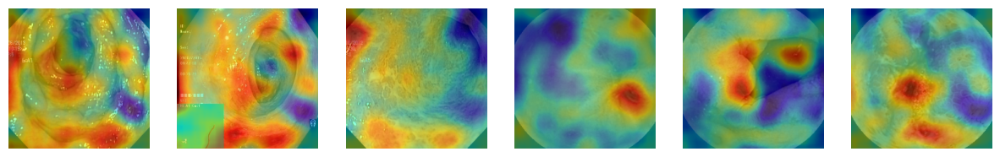

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

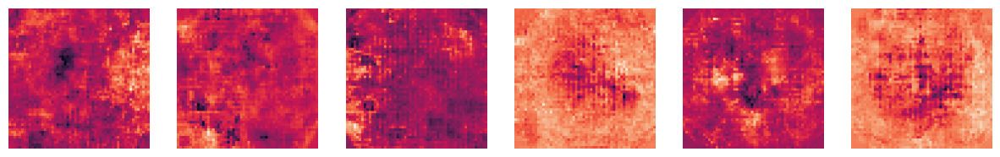

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_hybrid_s32, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

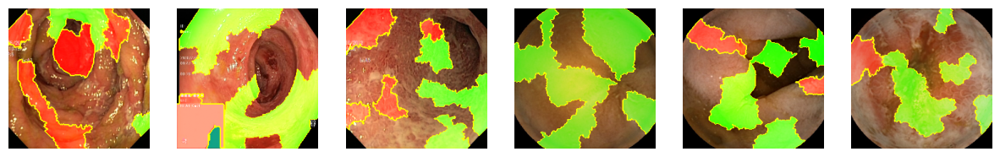

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 325.68it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.91it/s]


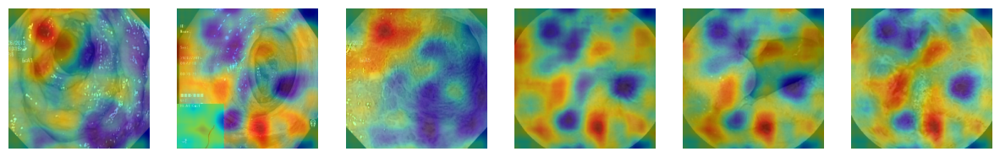

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

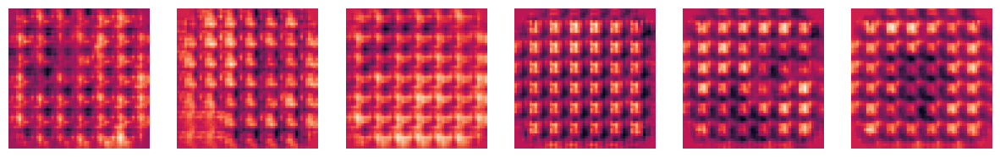

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

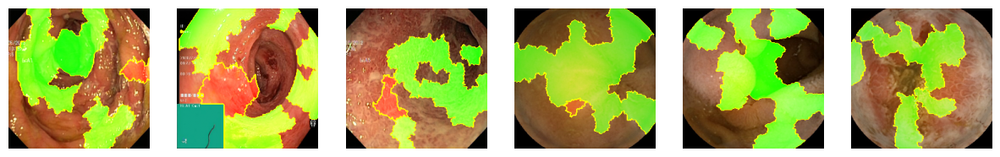

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 330.95it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 10.81it/s]


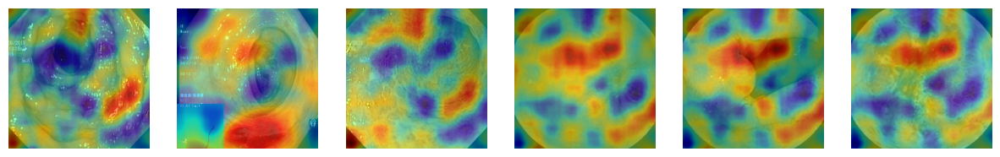

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

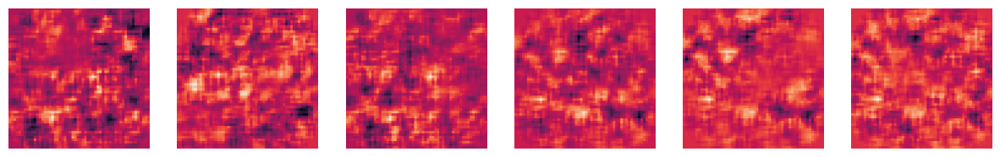

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1